> ## Visão Computacional

> Ulilé Indeque   
>
> William Gabriel
> ##### Professor: Thales Vieira - Segunda lista de exercício

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv

In [ ]:
def show_imgs(imgs, nrows=2, ncols=3):
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 8))
    for ax, img in zip(axes.flat, imgs):
        ax.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
        ax.axis('off')

def show_img(img):
    plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.axis("off")

## Questão - 1

Na documentação da OpenCV  ́e poss ́ıvel encontrar diversos detectores e descritores
Usando um conjunto com pelo menos 6 imagens (vocˆe
pode tirar fotos com seu telefone, por exemplo), experimente trˆes detectores
distintos nestas imagens, incluindo o detector de Harris. Pesquise e descreva
resumidamente com suas palavras (at ́e 200 palavras para cada) como cada
um funciona, incluindo seus parˆametros e quais suas principais diferen ̧cas.
Exiba resultados nas suas imagens, e em quais situa ̧c ̃oes cada um funciona

bem ou mal. Discuta seus parˆametros. Qual deles vocˆe achou melhor? Jus-
tifique.

In [ ]:
def harris_det(gray_img, img):
    harris = cv.cornerHarris(gray_img, 2, 3, 0.04)
    harris = cv.dilate(harris, None)
    im = img.copy()
    im[harris > 0.01 * harris.max()] = [255, 0, 0]
    return im

def orb_det(img):
    im = img.copy()
    orb = cv.ORB_create(nfeatures=20000)
    keyp, _ = orb.detectAndCompute(img, None)

    return cv.drawKeypoints(img, keyp, None, color=(0, 255, 0))

def sift_det(img):
    im = img.copy()
    sift = cv.SIFT_create(nfeatures=20000)
    keyp, _ = sift.detectAndCompute(img, None)

    return cv.drawKeypoints(img, keyp, None, color=(0, 0, 255),
                           flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)


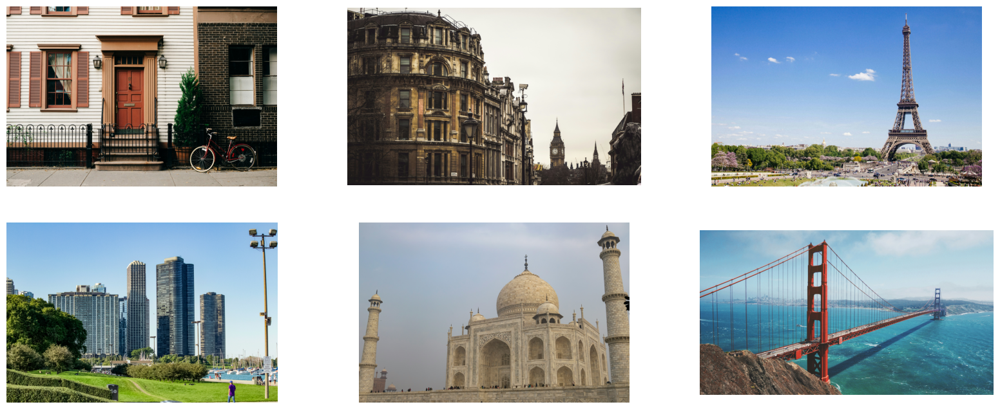

In [ ]:
path = [f"imgs/img{i}.jpg" for i in range(5, 11)]
imgs = list(map(lambda x: cv.imread(x), path))
gray_imgs = list(map(lambda img: cv.cvtColor(img, cv.COLOR_BGR2GRAY).astype("float32"), imgs))
show_imgs(imgs)

Usando Harris

O detector de cantos de Harris é uma técnica que permite identificar cantos em imagens. O seu funcionamento é baseado em calcular a variação de intensidade em pequenas regiões ao redor de cada (ponto de interesse), usando a Soma dos Quadrados das Diferenças (SSD(u, v)). A ideia é maximizar a função SSD. A partir da matriz M obtida pelas derivadas parciais da Imagem de entrada. Como M é simétrica, temos então det(M)=&lambda;1&lambda;2 e trans(M)=&lambda;1+&lambda;2. Com esses autovalores, obten-se a resposta R = det(M) - k*trans(M)^2, onde k varia de 0.04 a 0.06 que determina a presença de cantos de seguinte forma:
* se &lambda; e &lambda; forem muito pequenas, portanto R próximo do zero.
* se &lambda; >> &lambda; ou vice-versa, a região é uma aresta.
* se &lambda; &asymp; &lambda; e são ambos grandes, a região é um canto.

Segue o funcionamento do algoritmo:
* Converter a imagem original em uma imagem em escala de cinza I e depois calcula-se os valores dos pixels de I como uma soma ponderada dos valores correspondentes de R, G e B.
* Calcular as derivadas parciais Ix e Iy e aplicar a convolução usando o operador do Sobel.
* Calcular os produtos IxIx, IxIy, IyIy e aplicar convolução com gaussiano ou medio.
* Calcular a resposta para cada pixel.
* Definir limiar T para R e achar os pixeis que atendem.

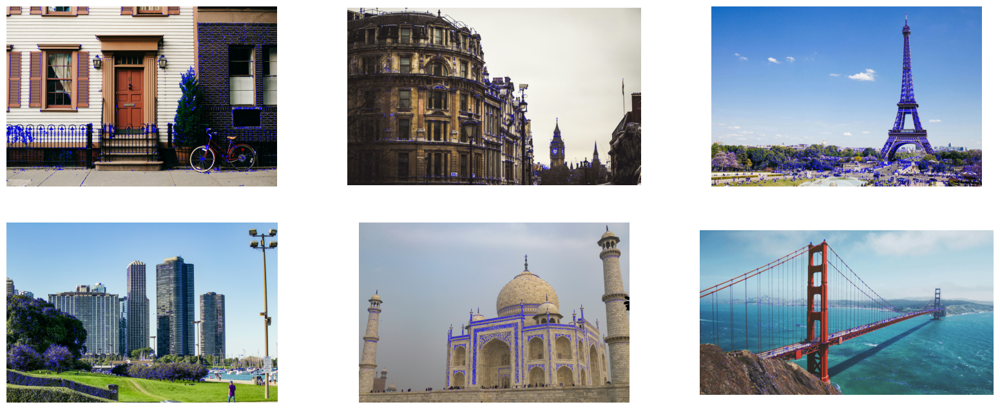

In [ ]:
harris_pimg = list(map(lambda gray_img, img: harris_det(gray_img, img), gray_imgs, imgs))
show_imgs(harris_pimg)

Usando ORB  

O ORB é uma junção do detector de pontos FAST e do descritor BRIEF, com algumas características adicionais para melhorar o desempenho. O FAST é um teste segmentado acelerado usado para detectar características da imagem fornecida. Ele também utiliza uma pirâmide para produzir características de múltiplas escalas. No entanto, o FAST não calcula a orientação e descritores das características, é aí que o BRIEF entra em cena.

O ORB basicamente utiliza FAST para detetar pontos, BRIEF para descritores e depois aplica harris para achar a quantidade dos pontos. Como o BRIEF tem um desempenho ruim em relação a rotação, o ORB roda o BRIEF de acordo com a orientação dos pontos-chave. Usando a orientação do patch, sua matriz de rotação é encontrada e roda o BRIEF para obter a versão rotacionada. Isso torna o ORB mais eficiente em relação aos algoritmos SIFT ou SURF usados para extração de características, tanto em custo computacional assim como no desempenho de correspondência.

Segue o algoritmo:
* converter a imagem para escala de cinza.
* inicializar o detector ORB e detectar os pontos-chave na imagem de entrada.
* achar os descritores.
* desenhar os pontos.

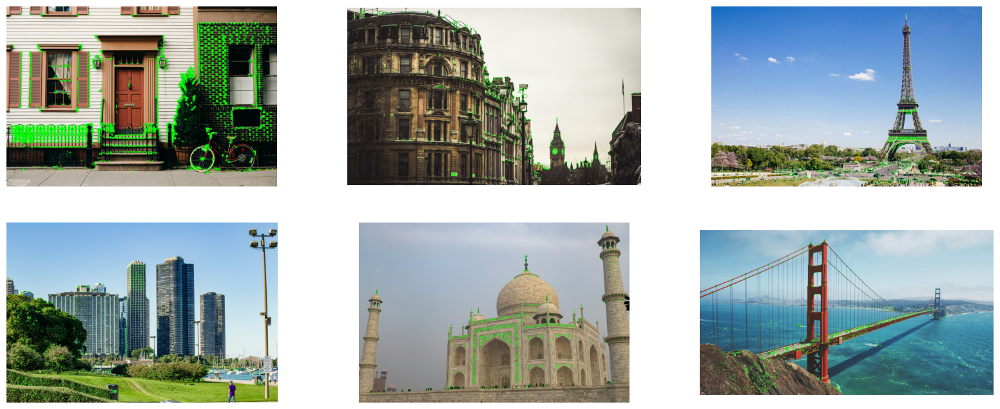

In [ ]:
pimg = list(map(lambda img: orb_det(img), imgs))
show_imgs(pimg)

Usando SIFT

O SIFT (Scale-Invariant Feature Transform) é um detector de características que identifica pontos de interesse em diferentes escalas e orientações em uma imagem. Ele usa um método de detecção de blobs para encontrar pontos de interesse que são invariantes a mudanças de escala e rotação. O SIFT também calcula descritores para esses pontos de interesse usando gradientes de intensidade de pixel em uma vizinhança ao redor de cada ponto. Os parâmetros importantes incluem o número de níveis de escala e o tamanho do filtro Gaussiano para suavização. O SIFT é robusto e preciso, mas pode ser computacionalmente intensivo.

Segue o algoritmo:
* Detecção de Escala e Orientação
* Localização dos Pontos de Interesse
* Cálculo dos Descritores de Características
* Atribuição de Orientação
* Construção do Vetor de Características


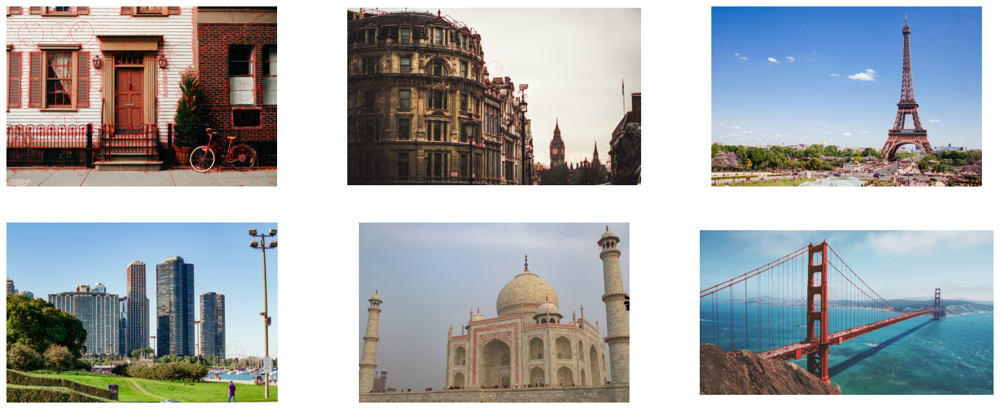

In [ ]:
pimg = list(map(lambda img: sift_det(img), imgs))
show_imgs(pimg)

Cada detector tem suas vantagens e desvantagens. O detector Harris é rápido, mas pode falhar em regiões com baixo contraste. O ORB é rápido e robusto a variações de iluminação e rotação, mas pode não ser tão preciso quanto o SIFT. O SIFT é altamente robusto e preciso, mas pode ser computacionalmente caro. Em termos de escolha, depende do contexto da aplicação. Para aplicações em tempo real onde a velocidade é crítica e a precisão não é tão crucial, o ORB pode ser preferível. Para aplicações onde a precisão é fundamental, como reconhecimento de objetos em imagens de alta resolução, o SIFT pode ser a melhor escolha.

## Questão - 2

> #### Repita o mesmo procedimento acima para 3 tipos de descritores, incluindo o SIFT.

In [ ]:
def fast_d(img):
    brief = cv.FastFeatureDetector_create()
    keyp = brief.detect(img, None)

    return cv.drawKeypoints(img, keyp, None, color=(255, 255, 0))

def orb_desc(img):
    orb = cv.ORB_create(nfeatures=20000)
    keyp = orb.detect(img, None)

    return cv.drawKeypoints(img, keyp, None, color=(255, 0, 255))

def sift_desc(img):
    sift = cv.SIFT_create(nfeatures=20000)
    keyp = sift.detect(img, None)

    return cv.drawKeypoints(img, keyp, None, color=(0, 255, 255),
                           flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)



Descritor FAST:

O descritor FAST (Features from Accelerated Segment Test) é um método para detecção de pontos de interesse em uma imagem. Ele funciona realizando um teste de segmento acelerado em torno de cada pixel para determinar se o pixel é um ponto de interesse. Este teste compara a intensidade do pixel central com a intensidade de pixels em uma circunferência ao redor dele. Se um número suficiente de pixels na circunferência for mais brilhante ou mais escuro que o pixel central, ele é considerado um ponto de interesse. Os principais parâmetros incluem o tamanho da vizinhança (N), que determina quantos pixels são comparados, e o limite de intensidade (t), que determina a diferença mínima necessária para considerar um pixel como um ponto de interesse. O descritor FAST é rápido e eficiente em termos de tempo de processamento, mas pode não ser tão robusto em relação a variações de escala e rotação.

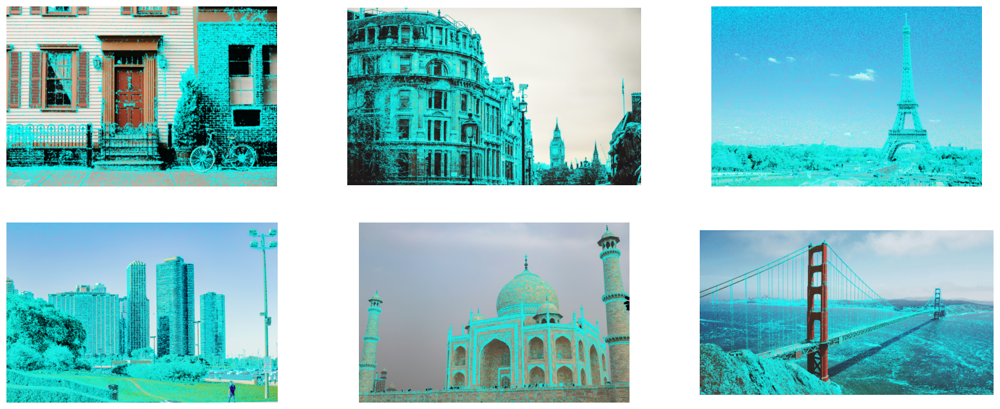

In [ ]:
pimg = list(map(lambda img: fast_d(img), imgs))
show_imgs(pimg)

Descritor ORB:

O descritor ORB (Oriented FAST and Rotated BRIEF) é uma combinação do detector FAST e do descritor BRIEF (Binary Robust Independent Elementary Features). O detector FAST identifica pontos de interesse com base em mudanças de intensidade de pixel em uma vizinhança, enquanto o descritor BRIEF gera descritores binários para esses pontos de interesse. Além disso, o ORB calcula a orientação dos pontos de interesse para tornar os descritores invariantes à rotação. Os principais parâmetros incluem o número de pontos de interesse a serem detectados e o tamanho da vizinhança para o detector FAST, bem como os parâmetros do descritor BRIEF. O ORB é rápido e robusto em relação a variações de iluminação e rotação.

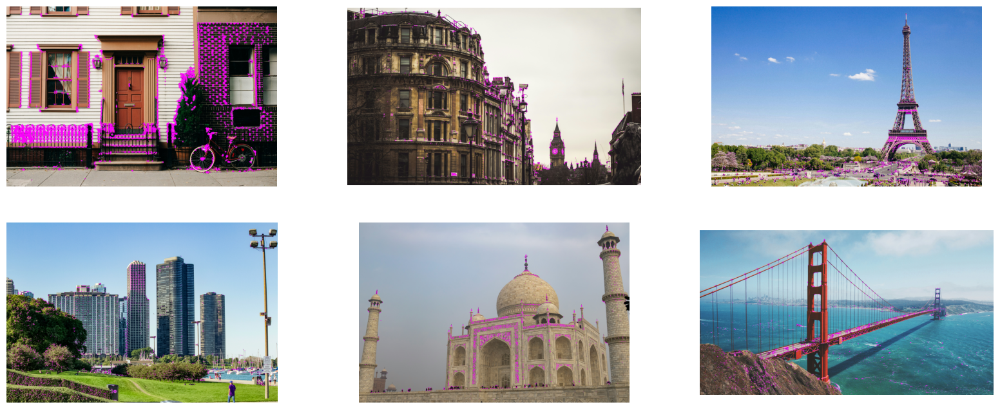

In [ ]:
pimg = list(map(lambda img: orb_desc(img), imgs))
show_imgs(pimg)

Descritor SIFT:

O descritor SIFT (Scale-Invariant Feature Transform) é um método para calcular descritores de características em pontos de interesse detectados em uma imagem. Ele usa gradientes de intensidade de pixel em uma vizinhança ao redor de cada ponto de interesse para calcular um descritor detalhado e robusto. Os principais parâmetros do SIFT incluem o número de níveis de escala, o tamanho do filtro Gaussiano para suavização e o tamanho do patch para calcular os gradientes de intensidade. O SIFT é conhecido por sua robustez e precisão, mas pode ser computacionalmente caro.

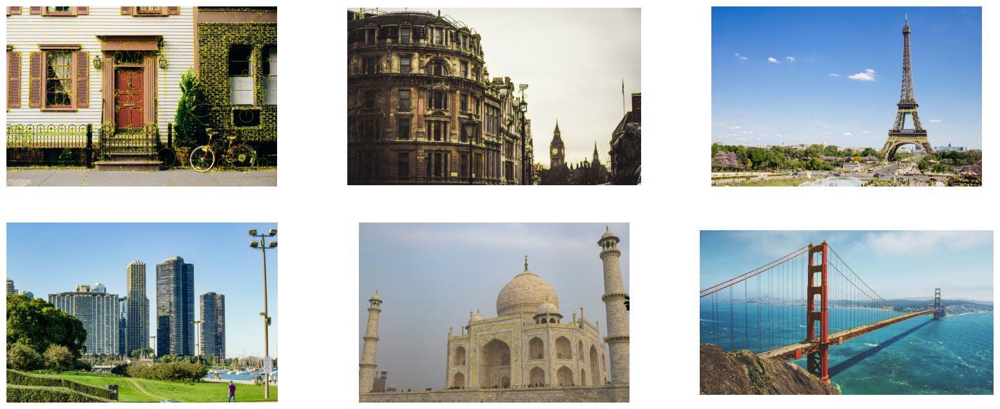

In [ ]:
pimg = list(map(lambda img: sift_desc(img), imgs))
show_imgs(pimg)

Cada descritor tem suas vantagens e desvantagens. O descritor FAST é rápido, mas pode não ser robusto em relação a variações de escala e rotação. O descritor ORB é rápido e robusto a variações de iluminação e rotação, mas pode não ser tão preciso quanto o SIFT. O descritor SIFT é robusto e preciso, mas pode ser computacionalmente intensivo. Em termos de escolha, depende do contexto da aplicação. Para aplicações em tempo real onde a velocidade é crítica e a precisão não é tão crucial, o descritor FAST pode ser preferível. Para aplicações onde a precisão é fundamental, como reconhecimento de objetos em imagens de alta resolução, o descritor SIFT pode ser a melhor escolha. O descritor ORB pode ser uma opção intermediária, oferecendo um equilíbrio entre velocidade e precisão.

## Questão - 3

In [ ]:
def bf_sift_matcher(imgs):

    sift = cv.SIFT_create(nfeatures=200)

    keyps1, descs1 = sift.detectAndCompute(imgs[0], None)
    keyps2, descs2 = sift.detectAndCompute(imgs[1], None)

    matcher = cv.BFMatcher()

    matches = matcher.knnMatch(descs1, descs2, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

    return cv.drawMatches(imgs[0], keyps1, imgs[1], keyps2, good_matches, None, matchColor=(255, 0, 0),
                          flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

def flann_matcher(imgs):
    sift = cv.SIFT_create(nfeatures=20000)

    keyps1, descs1 = sift.detectAndCompute(imgs[0], None)
    keyps2, descs2 = sift.detectAndCompute(imgs[1], None)

    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)

    flann = cv.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(descs1, descs2, k=2)

    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

    matched = cv.drawMatches(imgs[0], keyps1, imgs[1], keyps2, good_matches, None, matchColor=(0, 255, 0),
                              flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    return matched

def bf_orb_matcher(imgs):
    orb = cv.ORB_create(nfeatures=20000)

    keyps1, descs1 = orb.detectAndCompute(imgs[0], None)
    keyps2, descs2 = orb.detectAndCompute(imgs[1], None)

    bf = cv.BFMatcher()
    matches = bf.knnMatch(descs1, descs2, k=2)

    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)

    matched = cv.drawMatches(imgs[0], keyps1, imgs[1], keyps2, good_matches, None, matchColor=(0, 0, 255),
                                     flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    return matched

In [ ]:
def resize_rot(img):
    pairs = []
    pairs.append(img)
    scale_x = 0.75
    scale_y = 0.75

    resized_image = cv.resize(img, None, fx=scale_x, fy=scale_y)
    height, width = resized_image.shape[:2]
    """ rotation_matrix = cv.getRotationMatrix2D((width / 2, height / 2), -45, 1)
    resized_image = cv.warpAffine(resized_image, rotation_matrix, (width, height)) """
    pairs.append(resized_image)
    return pairs

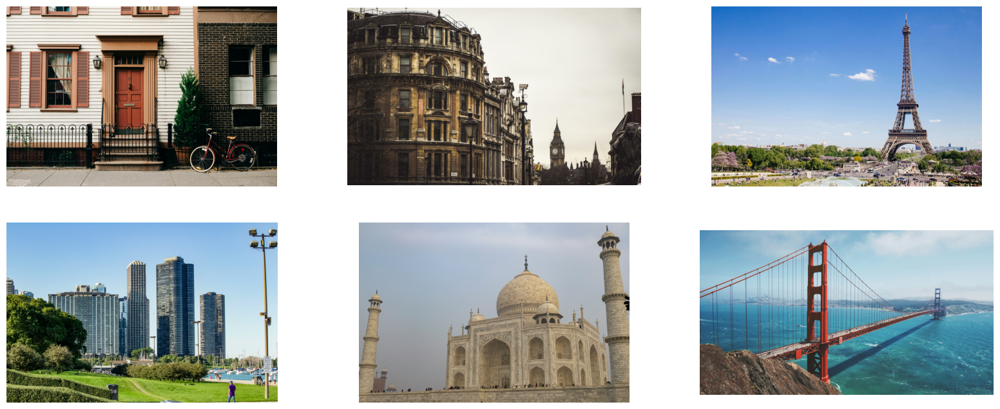

In [ ]:
path = [f"imgs/img{i}.jpg" for i in range(5, 11)]
imgs = list(map(lambda x: cv.imread(x), path))
gray_imgs = list(map(lambda img: cv.cvtColor(img, cv.COLOR_BGR2GRAY).astype("float32"), imgs))
show_imgs(imgs)

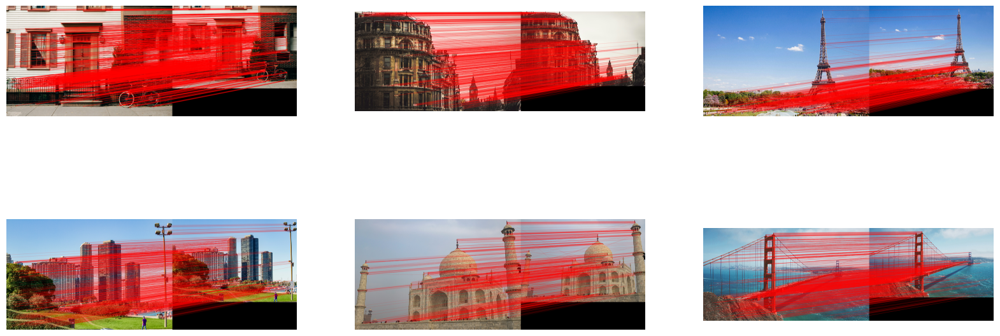

In [ ]:
pairs_imgs = list(map(lambda img: resize_rot(img), imgs))
pimg = list(map(lambda img: bf_orb_matcher(img), pairs_imgs))
show_imgs(pimg)

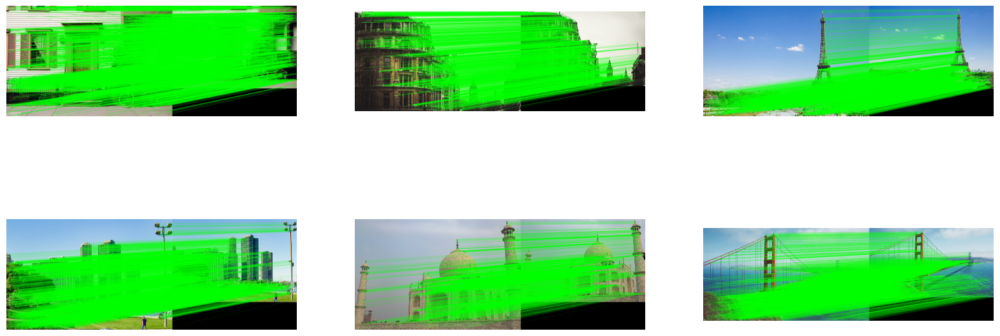

In [ ]:
pairs_imgs = list(map(lambda img: resize_rot(img), imgs))
pimg = list(map(lambda img: flann_matcher(img), pairs_imgs))
show_imgs(pimg)

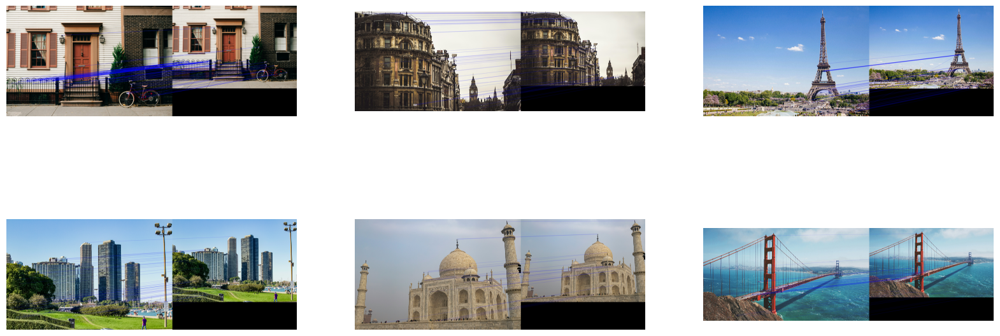

In [ ]:
pairs_imgs = list(map(lambda img: resize_rot(img), imgs))
pimg = list(map(lambda img: bf_sift_matcher(img), pairs_imgs))
show_imgs(pimg)

> ## Questão - 4

In [ ]:
import cv2
import os
import matplotlib.pyplot as plt

In [ ]:
def extract_orb_descriptors(image):
    orb = cv2.ORB_create(nfeatures=500)

    return orb.detectAndCompute(image, None)

def files_labels(labels_dir):
    for filename in os.listdir(labels_dir):
        image_path = os.path.join(labels_dir, filename)

        if os.path.isfile(image_path):
            gray_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
            color_image = cv2.imread(image_path)
            database[filename] = extract_orb_descriptors(gray_image)

            plt.imshow(cv2.cvtColor(color_image, cv2.COLOR_BGR2RGB))
            plt.title(filename)
            plt.show()


def identify_product(image):
    key, test_descriptors = extract_orb_descriptors(image)
    correspondences = {}

    for filename, (ref_keypoints, ref_descriptors) in database.items():
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
        matches = bf.match(test_descriptors, ref_descriptors)
        correspondences[filename] = len(matches)
    return max(correspondences, key=correspondences.get)

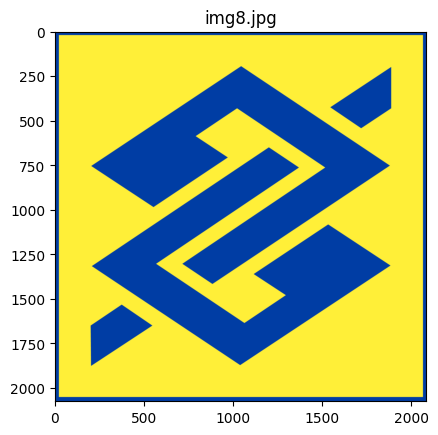

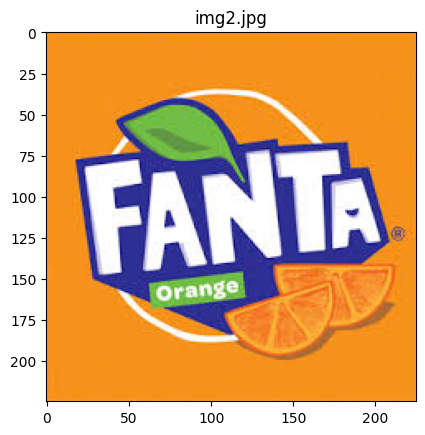

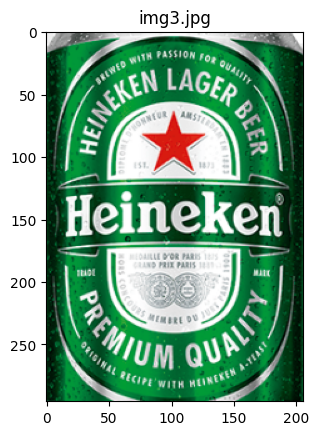

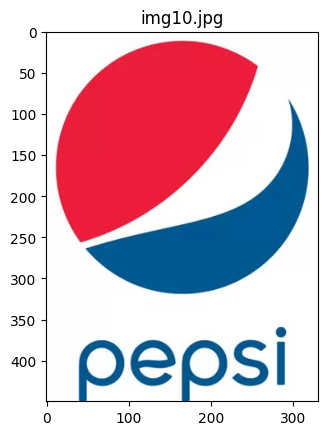

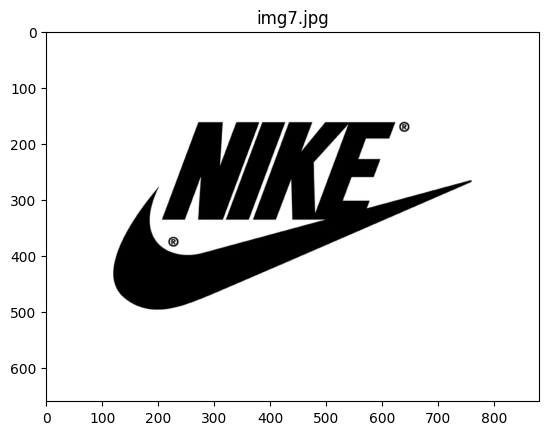

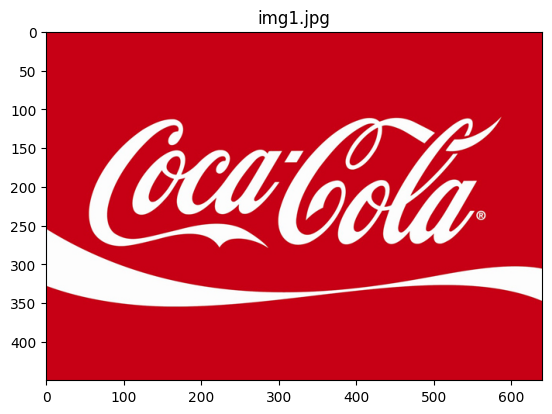

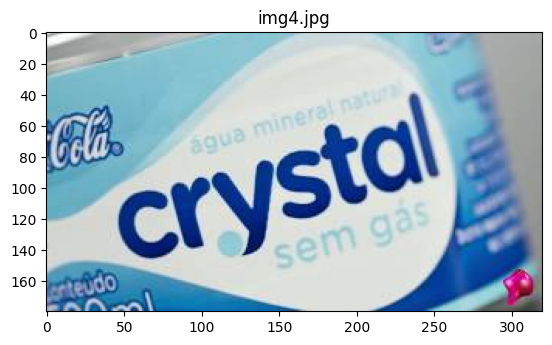

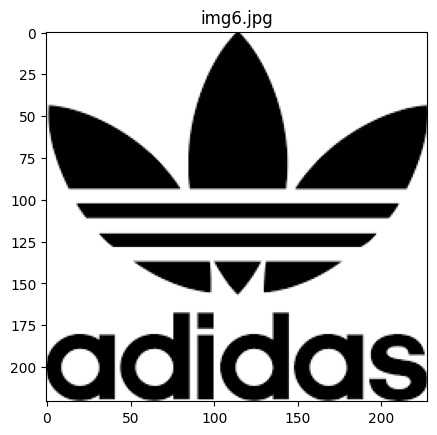

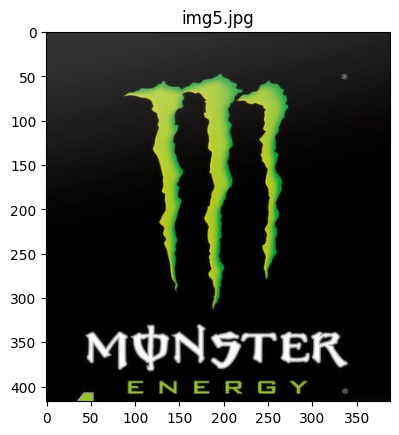

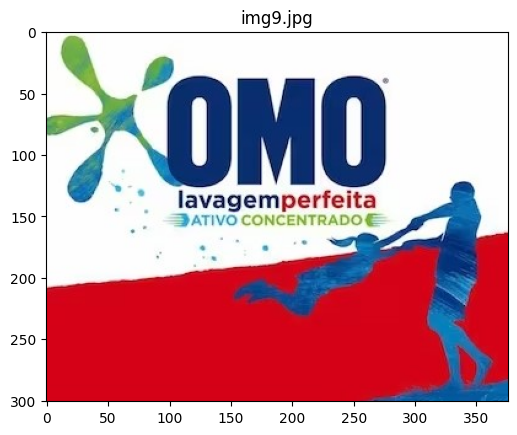

In [ ]:
database = {}
labels_dir = '/content/labels'
files_labels(labels_dir)

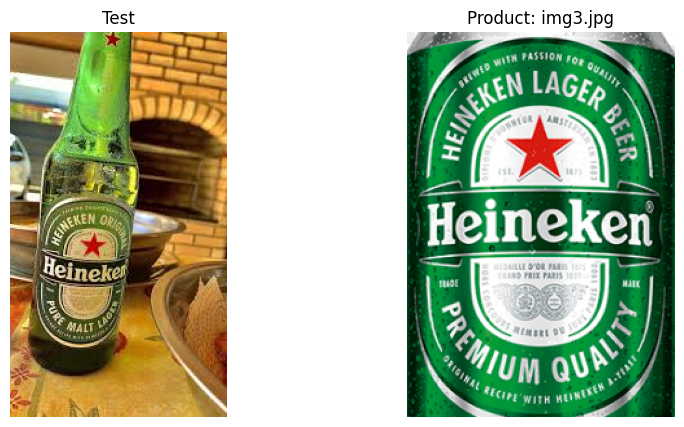

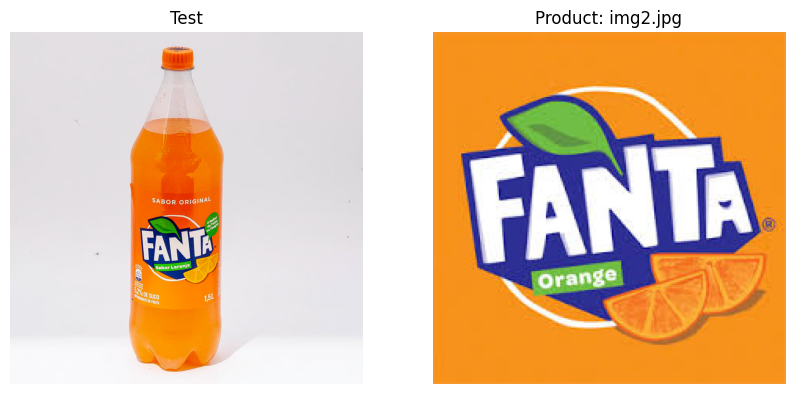

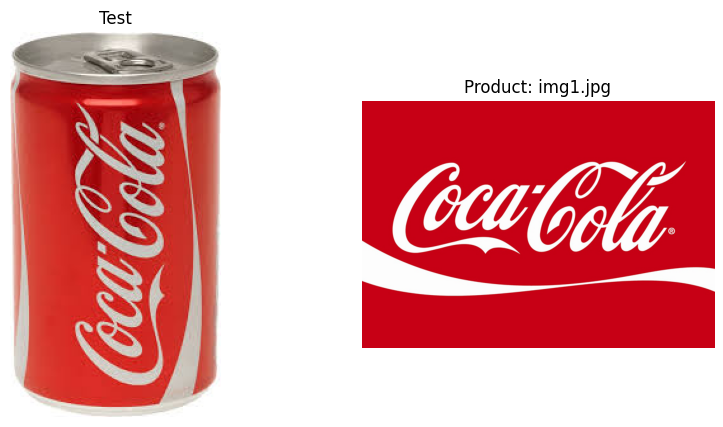

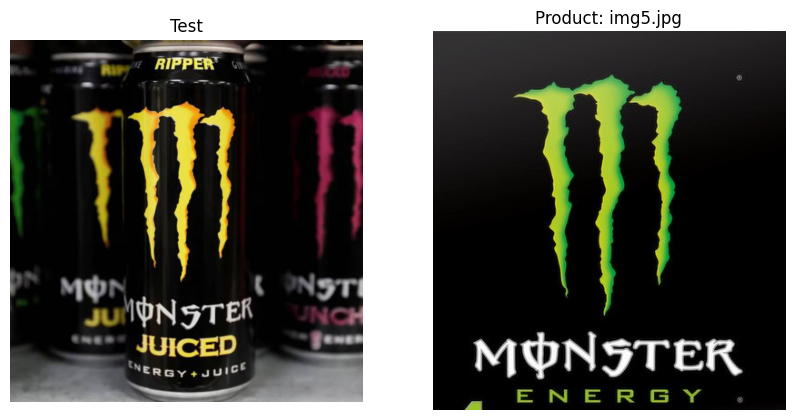

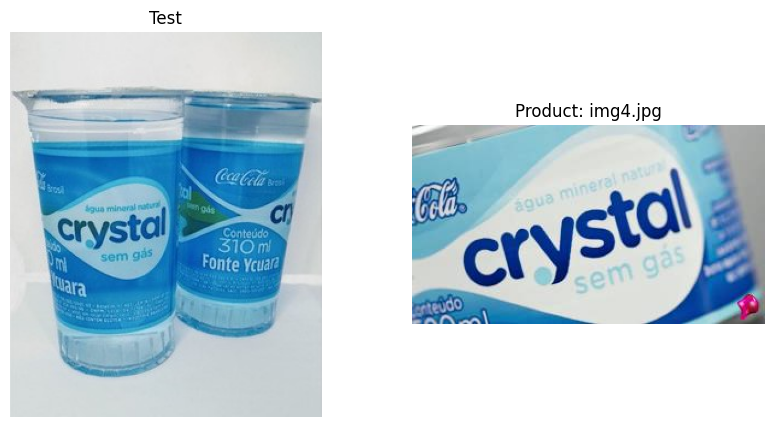

In [ ]:
for i in range(1, 6):
    test_image_path = f'/content/tests/t{i}.png'
    test_image = cv2.imread(test_image_path)
    test_image_gray =  cv2.imread(test_image_path, cv2.IMREAD_GRAYSCALE)

    identified_product = identify_product(test_image_gray)
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Test')
    axes[0].axis('off')

    label_image = cv2.imread(os.path.join(labels_dir, identified_product))
    axes[1].imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
    axes[1].set_title(f'Product: {identified_product}')
    axes[1].axis('off')

    plt.show()

Para gerar correspondências entre imagens de teste e imagens de rótulo usando o descritor de características ORB, a metodologia envolve os seguintes passos:

- Extração de Características ORB: Definir uma função extract_orb_descriptors(image) para extrair descritores ORB de uma imagem de entrada. Esta função inicializa um detector ORB com um número específico de características e calcula os descritores para a imagem de entrada usando o método detectAndCompute.

- Identificação de Produtos: Definir uma função identify_product(image) para identificar o produto em uma imagem de teste. Esta função primeiro extrai descritores ORB da imagem de entrada. Em seguida, itera sobre as imagens de rótulo, calculando o número de correspondências entre os descritores de teste e os descritores de cada rótulo usando o correspondente Brute-Force. O rótulo com o maior número de correspondências é selecionado como o produto identificado.

- Processamento de Imagens de Teste: Iterar sobre as imagens de teste usando um loop. Para cada imagem de teste, ler em formatos de cor e escala de cinza. Em seguida, identificar o produto na imagem de teste usando a função identify_product. Exibir a imagem de teste ao lado da imagem de rótulo identificada para visualização.

- Visualização: Exibir a imagem de teste e sua imagem de rótulo identificada lado a lado usando o Matplotlib.

- Interpretação dos Resultados: Analisar as imagens exibidas para confirmar visualmente a precisão da identificação do produto. Avaliar se a imagem de rótulo identificada corresponde ao conteúdo da imagem de teste conforme esperado.

- Otimização Adicional: Dependendo do desempenho e precisão, considerar técnicas de otimização adicionais, como ajustar parâmetros ORB, usar um detector de características diferente ou implementar algoritmos de correspondência mais avançados. Refinar continuamente a metodologia para melhorar o desempenho e a precisão.

> ## Questão - 5

In [ ]:
def show_imgs5(imgs, nrows=2, ncols=3):
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(16, 8))
    for ax, img in zip(axes.flat, imgs):
        ax.imshow(img, cmap="gray")
        ax.axis('off')

def show_img5(img):
    plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.axis("off")

def show_img_g5(img):
    plt.imshow(img, cmap='gray')
    plt.axis("off")

In [ ]:
def LoG_filter(image, sigma):
    smoothed = cv.GaussianBlur(image, (0,0), sigmaX=sigma)

    laplacian = cv.Laplacian(smoothed, cv.CV_64F)

    #laplacian = np.uint8(np.absolute(laplacian))
    return laplacian

def find_lmax(img):
    neighb = np.ones((3, 3))
    local_max = cv.dilate(img, neighb)
    full_lmax = (img == local_max)

    return full_lmax

def paiting(img, m):
    border_size = 1
    m[0:border_size, :] = False
    m[-border_size:, :] = False
    m[:, 0:border_size] = False
    m[:, -border_size:] = False
    colored = cv.cvtColor((img / img.max() * 255)
                          .astype(np.uint8), cv.COLOR_GRAY2BGR)
    colored[m] = [0, 0, 255]
    return colored
    #print(colored.shape)

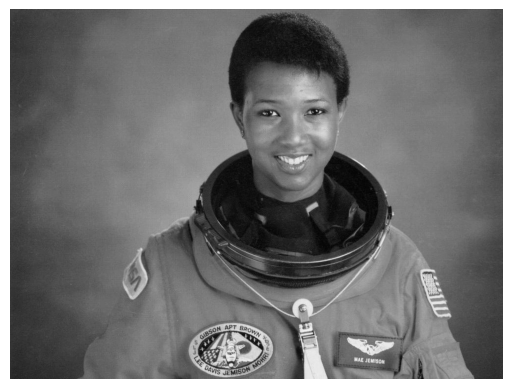

In [ ]:
img = cv.imread("jemisson.jpg", cv.IMREAD_GRAYSCALE)
show_img_g5(img)

In [ ]:
scales = [1, 1.4, 2, 2.4, 16, 32]
logs_img = list(map(lambda x: LoG_filter(img, x), scales))  # aplica filtro log que consiste em suavizar imagem
                                                            # e depois captura segunda deriva usando laplace

lmax = list(map(lambda img: find_lmax(img), logs_img))      # extrair os maximos locais atraves de operação de dilação

colored_img = list(map(lambda img, m: paiting(img, m), logs_img, lmax)) # pinta as image, usando os máximos como máscara

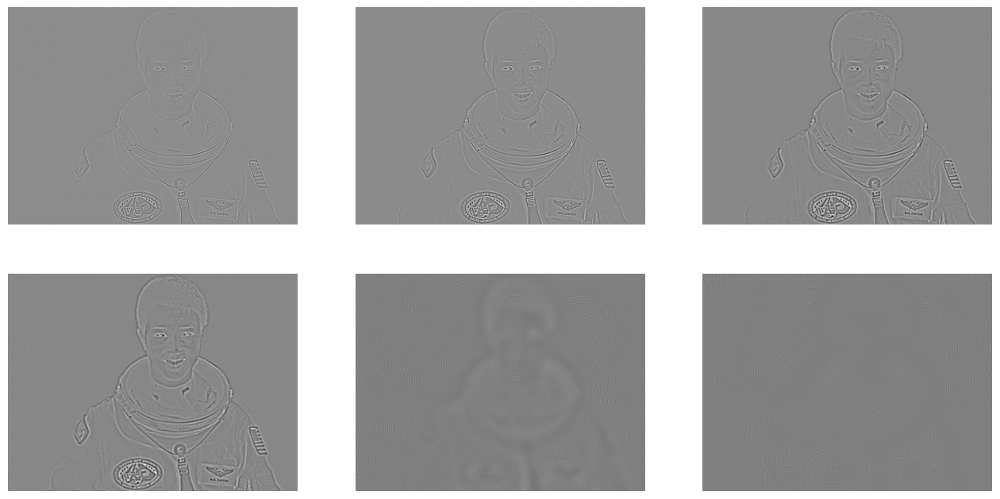

In [ ]:
show_imgs5(logs_img)

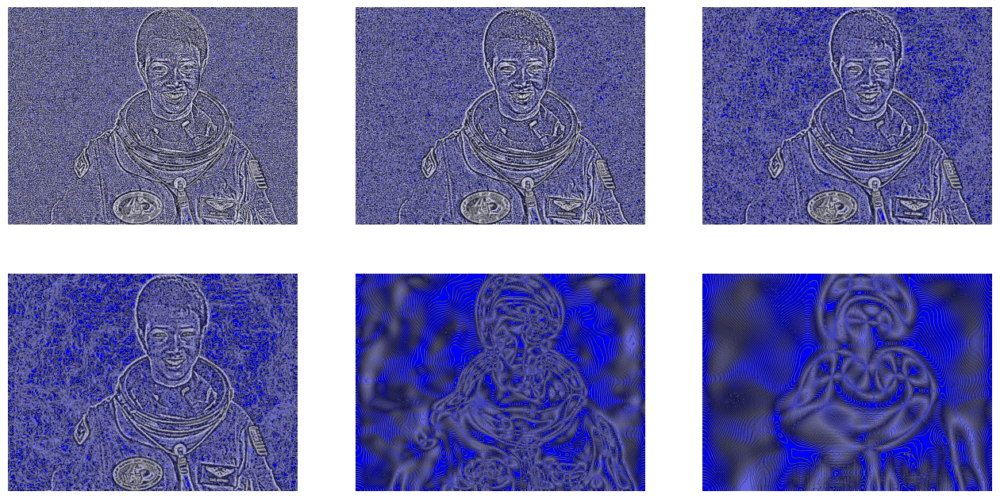

In [ ]:
show_imgs5(colored_img)